## **라이브러리 import**

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.models as models

import PIL
import matplotlib.pyplot as plt

import copy

import gdown
import zipfile

## **이미지 로딩 및 전처리**

- 이미지를 텐서 형식으로 변환
- 모델의 입력으로 사용하기 위해 배치 차원을 추가

##   **변환된 이미지 시각화**
- 모델 입력을 위해 추가했던 배치 차원을 제거하여 이미지 형태로 복원


In [ ]:
# GPU 설정
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# 이미지를 불러와 다운받아 텐서로 변환하는 함수
def image_loader(img_path, imsize):
    loader = transforms.Compose([
        transforms.Resize(imsize), # 이미지의 크기를 변경
        transforms.ToTensor() # Tensor 형식으로 변경
    ])
    image = PIL.Image.open(img_path)
    # 네트워크 입력에 들어갈 이미지에 차원추가
    image = loader(image).unsqueeze(0)
    return image.to(device, torch.float)


# Tensor 형태의 이미지를 화면에 출력하는 함수
def imshow(tensor):
    # matplotlib는 CPU 기반이므로 CPU로 옮기기
    image = tensor.cpu().clone()
    # torch.Tensor에서 사용되는 차원 제거
    image = image.squeeze(0)
    # PIL 객체로 변경
    image = transforms.ToPILImage()(image)

    plt.imshow(image)
    plt.show()

## 데이터셋 다운로드

In [ ]:
file_id = "1Q_jbI25NfqZvuwWv53slmovqyW_L4k2r"
output_file = "StyleBench.zip"

# 파일 다운로드
gdown.download(f"https://drive.google.com/uc?id={file_id}", output_file, quiet=False)


# 압축 파일 풀기
with zipfile.ZipFile(output_file, 'r') as zip_ref:
    zip_ref.extractall("./StyleBench")


Downloading...
From (original): https://drive.google.com/uc?id=1Q_jbI25NfqZvuwWv53slmovqyW_L4k2r
From (redirected): https://drive.google.com/uc?id=1Q_jbI25NfqZvuwWv53slmovqyW_L4k2r&confirm=t&uuid=a7400727-6f7b-4cca-893c-6f142d899e48
To: /content/StyleBench.zip
100%|██████████| 92.7M/92.7M [00:00<00:00, 106MB/s]


## CNN 네트워크 불러오기

* 특징 추출기(feature extractor)로 VGG 네트워크를 사용

In [ ]:
cnn = models.vgg19(pretrained=True).features.to(device).eval()

# Normalization을 위한 초기화
cnn_normalization_mean = torch.tensor([0.485, 0.456, 0.406]).to(device)
cnn_normalization_std = torch.tensor([0.229, 0.224, 0.225]).to(device)


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:07<00:00, 77.4MB/s]


**이미지 정규화**
- 스타일 변환을 수행하기전 이미지를 정규화
- 채널별로 정규화 연산이 가능하도록 설정

**Gram Matrix 계산**
- 스타일 정보를 추출하기 위해 gram matrix 계산
- 특징 맵을 2차원 행렬 형태로 변환 후 특징 맵 간 내적을 수행하여 gram matrix 계산

**스타일 손실 및 컨텐츠 손실 정의**
- 스타일 손실에서는 생성된 이미지 스타일이 목표 스타일과 얼마나 일치하는지 평가하기 위해 Gram Matrix를 비교
- fowrad()에서는 MSE 손실을 활용해 계산

In [ ]:
class Normalization(nn.Module):
    def __init__(self, mean, std):
        super(Normalization, self).__init__()
        self.mean = mean.clone().view(-1, 1, 1)
        self.std = std.clone().view(-1, 1, 1)

    def forward(self, img):
        return (img - self.mean) / self.std

def gram_matrix(input):
    # a는 배치 크기, b는 특징 맵의 개수, (c, d)는 특징 맵의 차원을 의미
    a, b, c, d = input.size()
    features = input.view(a * b, c * d)
    G = torch.mm(features, features.t())
    return G.div(a * b * c * d)


# style loss 클래스 정의
class StyleLoss(nn.Module):
    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        self.target = gram_matrix(target_feature).detach()

    def forward(self, input):
        G = gram_matrix(input)
        self.loss = F.mse_loss(G, self.target)
        return input


# content loss 클래스 정의
class ContentLoss(nn.Module):
    def __init__(self, target,):
        super(ContentLoss, self).__init__()
        self.target = target.detach()

    def forward(self, input):
        self.loss = F.mse_loss(input, self.target)
        return input

### **컨텐츠 및 스타일 레이어 선택**
- 텐츠 정보는 conv_4에서 추출
- 스타일 정보는 1, 3, 5, 7, 9번째 conv에서 추출

###  **스타일 변환 손실 계산 함수 정의**
- VGG 네트워크의 각 레이어를 하나씩 추가하면서 컨텐츠 및 스타일 손실을 추출
- conv_4 레이어에서 컨텐츠 특징을 추출하여 ContentLoss를 계산
- conv_1, conv_3, conv_5, conv_7, conv_9 레이어에서 스타일 정보를 추출하여 StyleLoss 계산
- 손실이 추가된 마지막 레이어까지만 모델을 사용

In [ ]:
content_layers = ['conv_4']
style_layers = ['conv_1', 'conv_3', 'conv_5', 'conv_7', 'conv_9']

# Style Transfer loss 계산하는 함수
def get_losses(cnn, content_img, style_img, noise_image):
    cnn = copy.deepcopy(cnn)
    normalization = Normalization(cnn_normalization_mean, cnn_normalization_std).to(device)
    content_losses = []
    style_losses = []

    model = nn.Sequential(normalization)

    i = 0
    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = 'conv_{}'.format(i)
        elif isinstance(layer, nn.ReLU):
            name = 'relu_{}'.format(i)
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = 'pool_{}'.format(i)
        elif isinstance(layer, nn.BatchNorm2d):
            name = 'bn_{}'.format(i)
        else:
            raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

        model.add_module(name, layer)

        # 설정한 content layer까지의 결과를 이용해 content loss를 계산
        if name in content_layers:
            target_feature = model(content_img).detach()
            content_loss = ContentLoss(target_feature)
            model.add_module("content_loss_{}".format(i), content_loss)
            content_losses.append(content_loss)

        # 설정한 style layer까지의 결과를 이용해 style loss를 계산
        if name in style_layers:
            target_feature = model(style_img).detach()
            style_loss = StyleLoss(target_feature)
            model.add_module("style_loss_{}".format(i), style_loss)
            style_losses.append(style_loss)

    # 마지막 loss 이후의 레이어는 사용하지 않도록
    for i in range(len(model) - 1, -1, -1):
        if isinstance(model[i], ContentLoss) or isinstance(model[i], StyleLoss):
            break

    model = model[:(i + 1)]
    return model, content_losses, style_losses

### **스타일 변환 함수 정의**
- 스타일 변환 과정
  1. 컨텐츠 및 스타일 손실 설정
  2. 초기 입력 이미지 출력
  3. 스타일 변환 반복 수행
  4. 학습 진행 상황 출력
  5. 최종 이미지 후처리



In [ ]:
def style_transfer(cnn, content_img, style_img, input_img, iters):
    model, content_losses, style_losses = get_losses(cnn, content_img, style_img, input_img)
    optimizer = optim.LBFGS([input_img.requires_grad_()])

    print("[ Start ]")
    imshow(input_img)

    # 하나의 값만 이용하기 위해 배열 형태로 사용
    run = [0]
    while run[0] <= iters:

        def closure():
            input_img.data.clamp_(0, 1)

            optimizer.zero_grad()
            model(input_img)
            content_score = 0
            style_score = 0

            for cl in content_losses:
                content_score += cl.loss
            for sl in style_losses:
                style_score += sl.loss

            style_score *= 1e5
            loss = content_score + style_score
            loss.backward()

            run[0] += 1
            if run[0] % 100 == 0:
                print(f"[ Step: {run[0]} / Content loss: {content_score.item()} / Style loss: {style_score.item()}]")
                imshow(input_img)

            return content_score + style_score

        optimizer.step(closure)

    # 결과적으로 이미지의 각 픽셀의 값이 [0, 1] 사이의 값이 되도록 자르기
    input_img.data.clamp_(0, 1)

    return input_img

## **Style Transfer 실행①**

[ Content Image ]


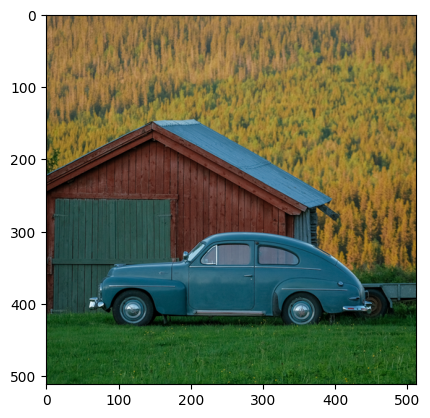

[ Style Image ]


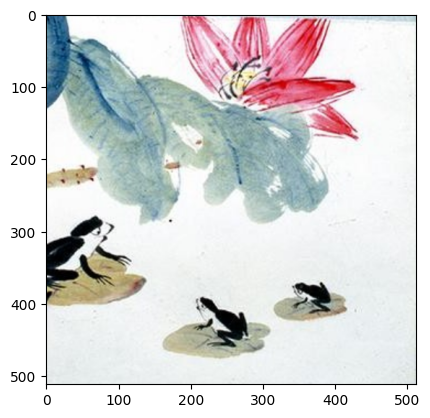

In [ ]:
content_img = image_loader('/content/StyleBench/content/A car in front of the cottage.png', (512, 512))
style_img = image_loader('/content/StyleBench/style/Anime 05/05.jpg', (512, 512))

print("[ Content Image ]")
imshow(content_img)
print("[ Style Image ]")
imshow(style_img)

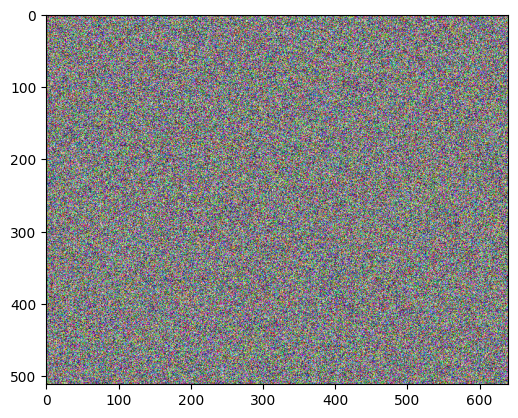

In [ ]:
# 콘텐츠 이미지와 동일한 크기의 노이즈 이미지 준비
input_img = torch.empty_like(content_img).uniform_(0, 1).to(device)


[ Start ]


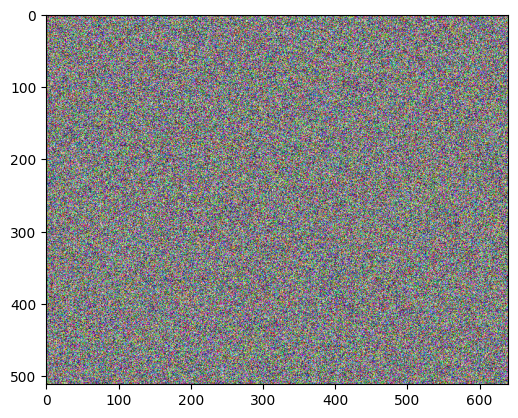

[ Step: 100 / Content loss: 17.705066680908203 / Style loss: 28.199697494506836]


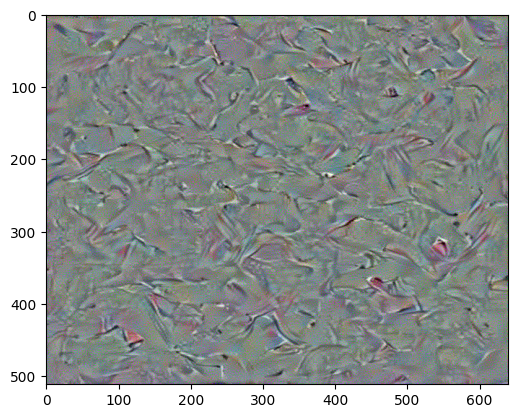

[ Step: 200 / Content loss: 12.96202564239502 / Style loss: 20.957061767578125]


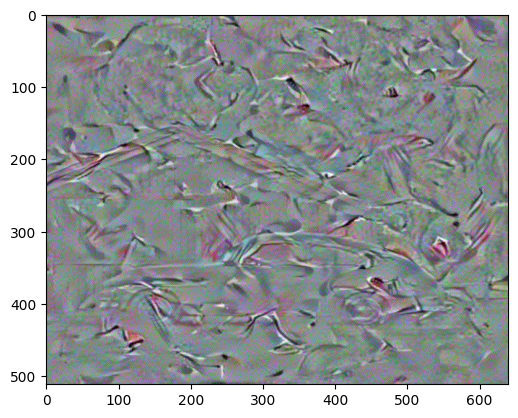

[ Step: 300 / Content loss: 10.478456497192383 / Style loss: 17.485822677612305]


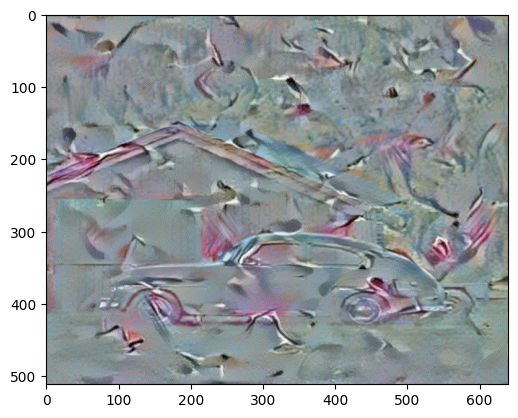

[ Step: 400 / Content loss: 9.188995361328125 / Style loss: 13.952945709228516]


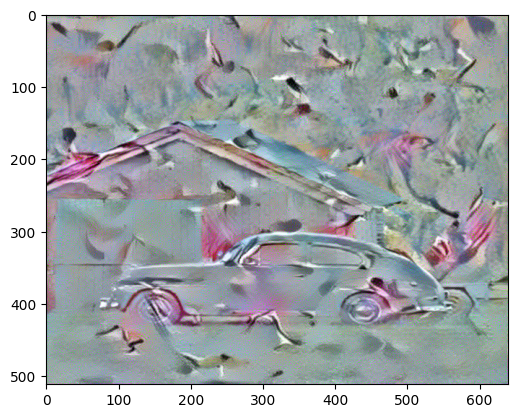

[ Step: 500 / Content loss: 8.494402885437012 / Style loss: 9.648436546325684]


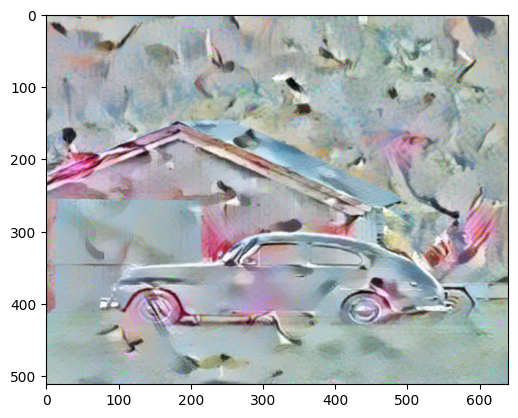

[ Step: 600 / Content loss: 8.144493103027344 / Style loss: 6.948375225067139]


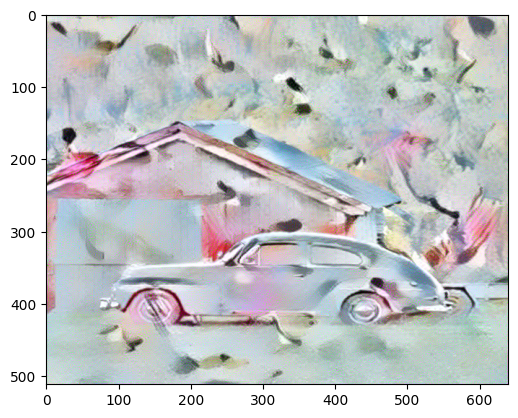

[ Step: 700 / Content loss: 7.8317484855651855 / Style loss: 3.882794141769409]


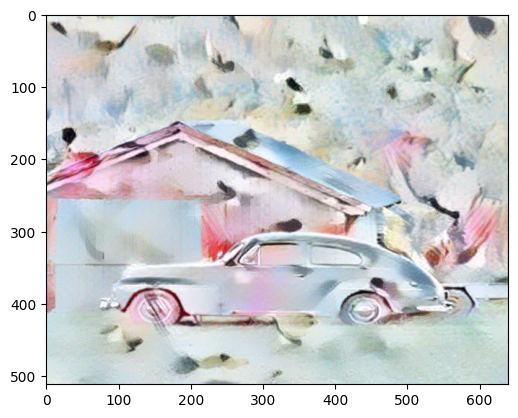

[ Step: 800 / Content loss: 7.384768962860107 / Style loss: 2.5280303955078125]


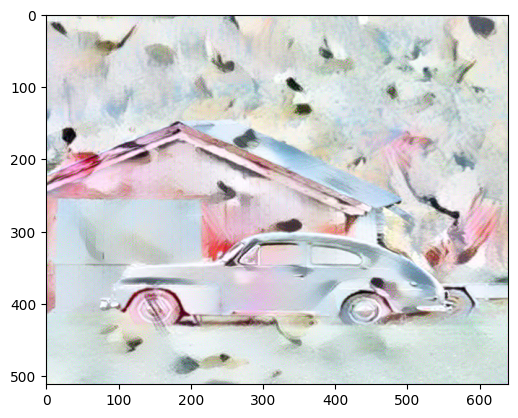

[ Step: 900 / Content loss: 7.0018815994262695 / Style loss: 1.9533942937850952]


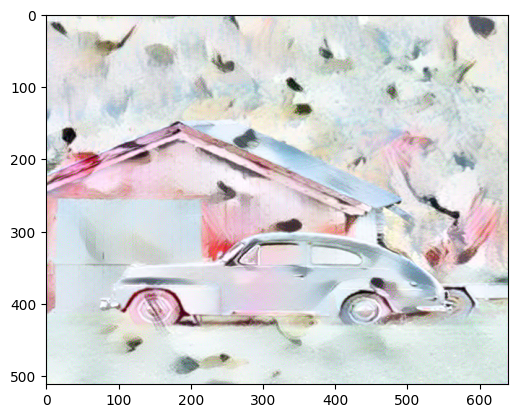

In [ ]:
from torchvision.utils import save_image
from google.colab import files
from IPython.display import Image

output = style_transfer(cnn, content_img=content_img, style_img=style_img, input_img=input_img, iters=900)

save_image(output.cpu().detach()[0], 'output_1.png')

## **Style Transfer 실행②**

[ Content Image ]


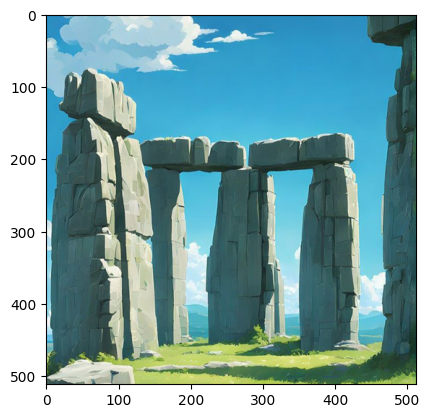

[ Style Image ]


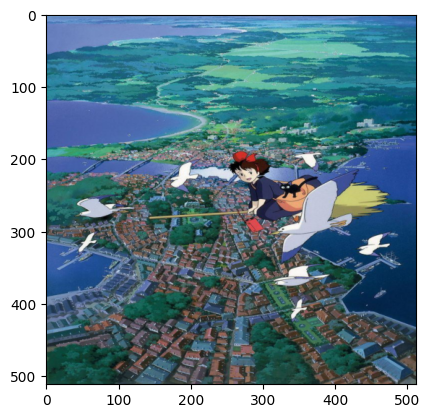

In [ ]:
content_img = image_loader('/content/StyleBench/content/Sky, Stonehenge.png', (512, 512))
style_img = image_loader('/content/StyleBench/style/Anime 06/02.jpg', (512, 512))

print("[ Content Image ]")
imshow(content_img)
print("[ Style Image ]")
imshow(style_img)

[ Start ]


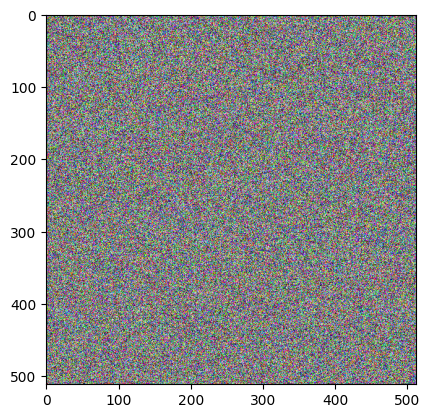

[ Step: 100 / Content loss: 31.54132843017578 / Style loss: 31.54749870300293]


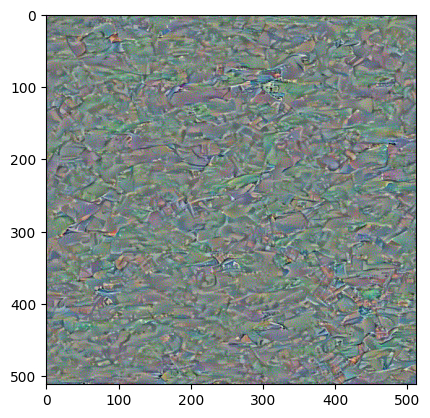

[ Step: 200 / Content loss: 25.778858184814453 / Style loss: 11.41298770904541]


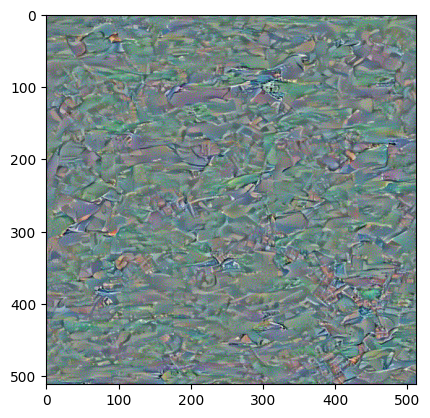

[ Step: 300 / Content loss: 19.84947967529297 / Style loss: 6.7776055335998535]


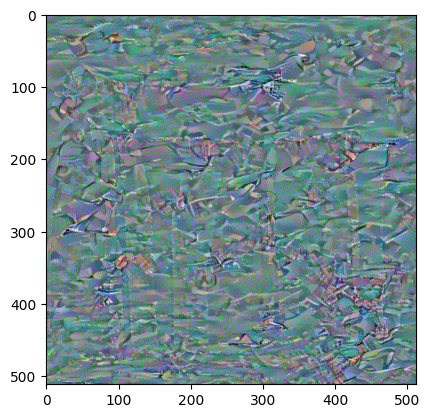

[ Step: 400 / Content loss: 16.410497665405273 / Style loss: 4.681728839874268]


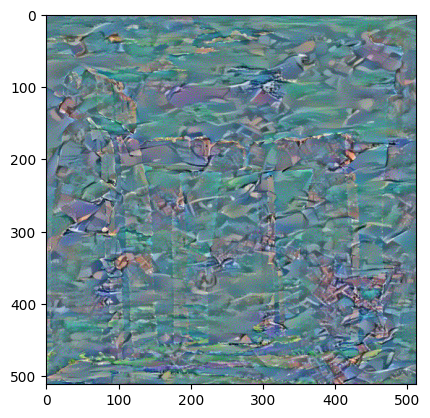

[ Step: 500 / Content loss: 14.048990249633789 / Style loss: 3.4654464721679688]


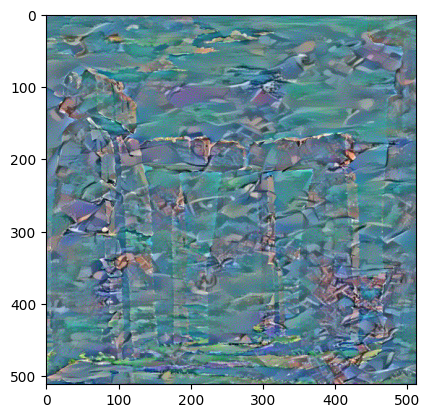

[ Step: 600 / Content loss: 12.455981254577637 / Style loss: 2.7759058475494385]


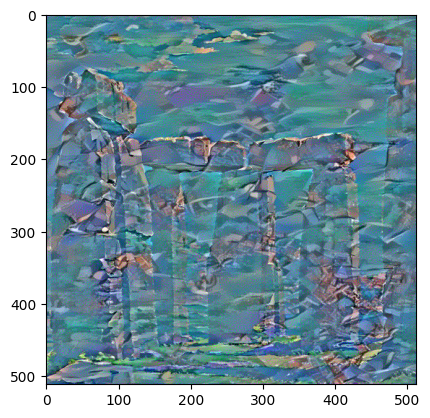

[ Step: 700 / Content loss: 11.301864624023438 / Style loss: 2.368602991104126]


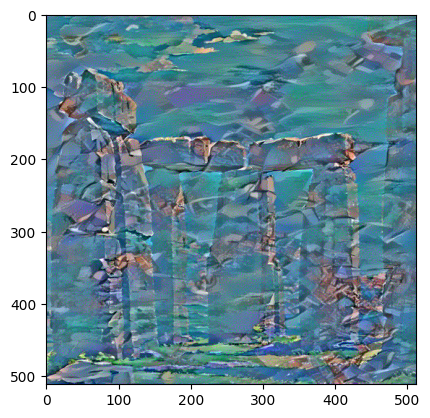

[ Step: 800 / Content loss: 10.458589553833008 / Style loss: 2.084963321685791]


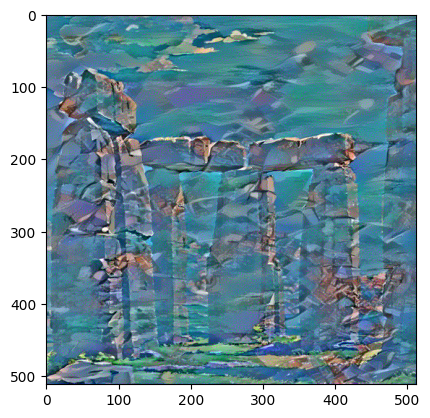

[ Step: 900 / Content loss: 9.810001373291016 / Style loss: 1.8924903869628906]


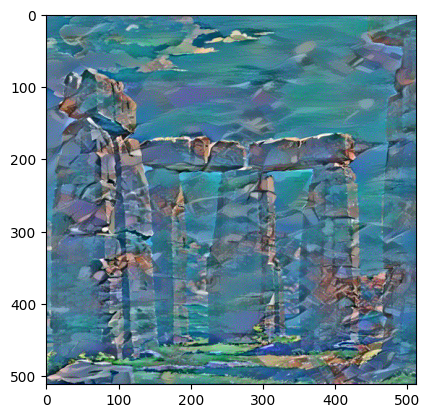

In [ ]:
input_img = torch.empty_like(content_img).uniform_(0, 1).to(device)

output = style_transfer(cnn, content_img=content_img, style_img=style_img, input_img=input_img, iters=900)

save_image(output.cpu().detach()[0], 'output_2.png')

## **Style Transfer 실행③**

[ Content Image ]


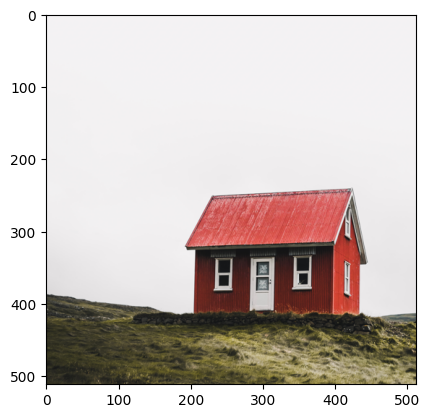

[ Style Image ]


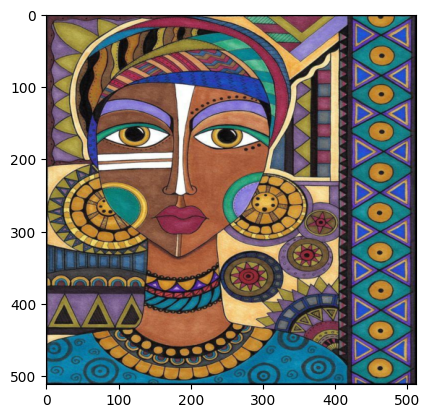

In [ ]:
content_img = image_loader('/content/StyleBench/content/Log Cabin.png', (512, 512))
style_img = image_loader('/content/StyleBench/style/Folk art/01.jpg', (512, 512))

print("[ Content Image ]")
imshow(content_img)
print("[ Style Image ]")
imshow(style_img)

[ Start ]


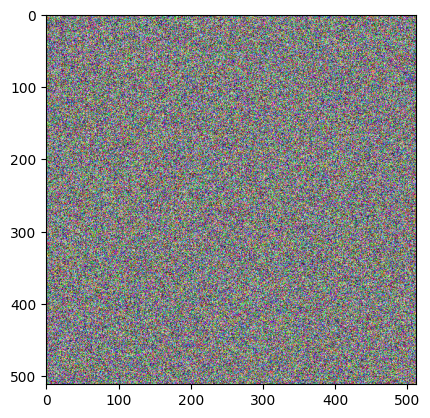

[ Step: 100 / Content loss: 55.37395477294922 / Style loss: 138.94464111328125]


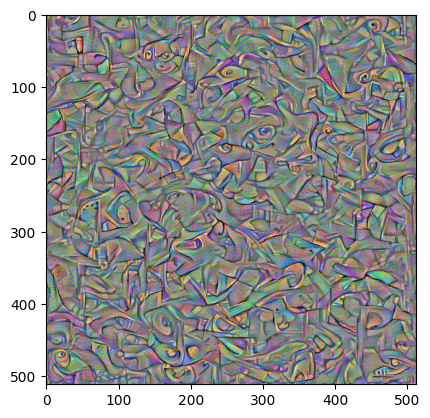

[ Step: 200 / Content loss: 53.60613250732422 / Style loss: 42.30940246582031]


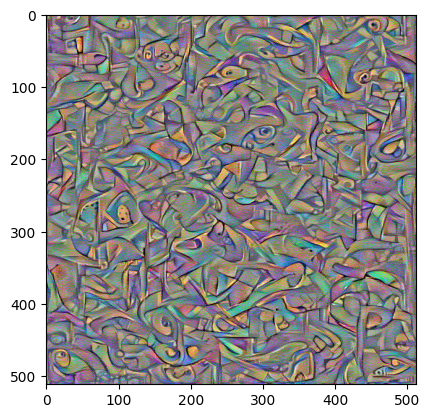

[ Step: 300 / Content loss: 51.346160888671875 / Style loss: 23.70058822631836]


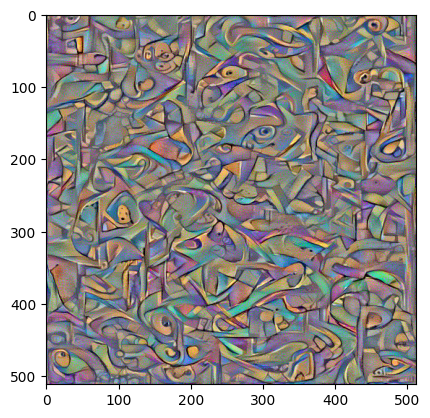

[ Step: 400 / Content loss: 49.064395904541016 / Style loss: 16.727338790893555]


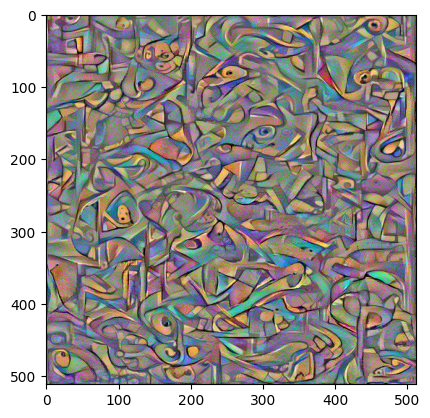

[ Step: 500 / Content loss: 47.20278549194336 / Style loss: 13.530998229980469]


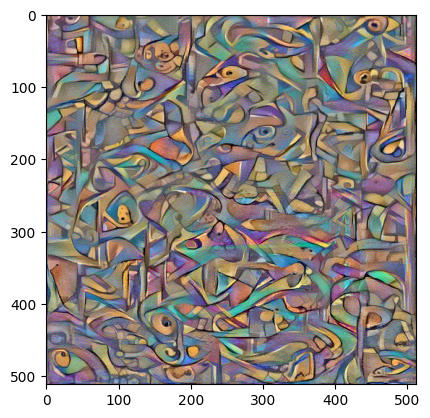

[ Step: 600 / Content loss: 45.55889892578125 / Style loss: 11.535083770751953]


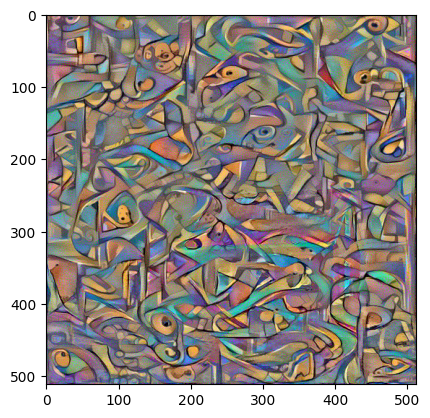

[ Step: 700 / Content loss: 44.25524139404297 / Style loss: 10.316638946533203]


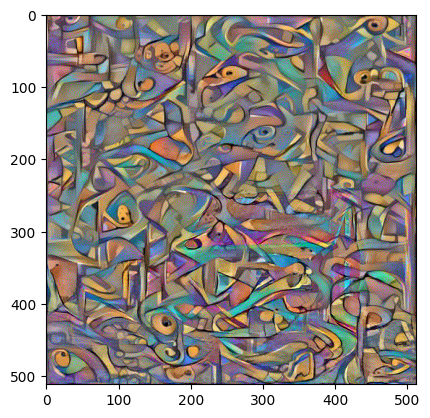

[ Step: 800 / Content loss: 43.17610168457031 / Style loss: 9.302165031433105]


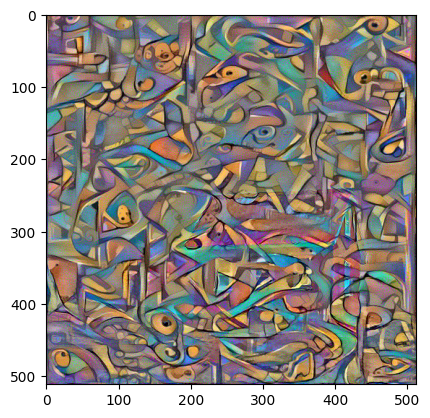

[ Step: 900 / Content loss: 42.187896728515625 / Style loss: 8.583620071411133]


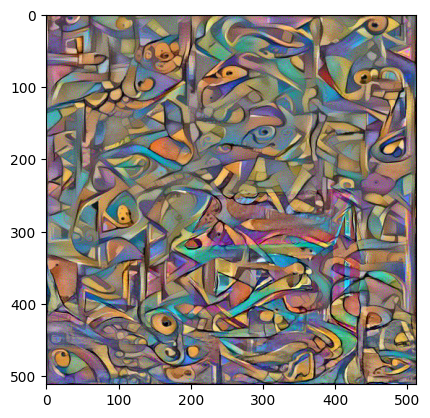

In [ ]:
input_img = torch.empty_like(content_img).uniform_(0, 1).to(device)

output = style_transfer(cnn, content_img=content_img, style_img=style_img, input_img=input_img, iters=900)

save_image(output.cpu().detach()[0], 'output_3.png')

## **Style Transfer 실행 결과**

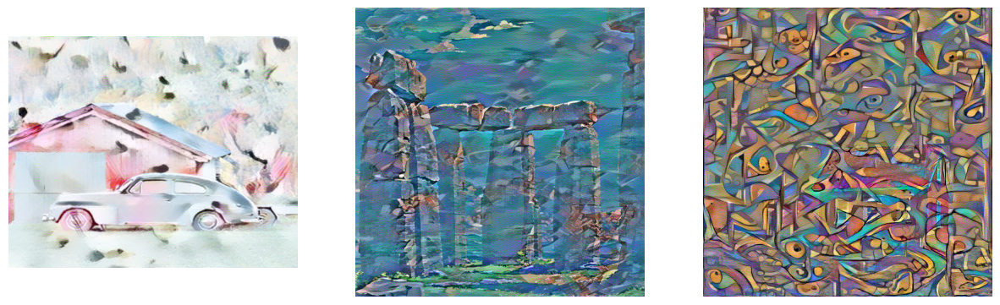

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# 파일 리스트
image_files = ['output_1.png', 'output_2.png', 'output_3.png']

# 서브플롯 생성
fig, axes = plt.subplots(1, len(image_files), figsize=(15, 5))

# 각 이미지 표시
for ax, img_path in zip(axes, image_files):
    img = mpimg.imread(img_path)
    ax.imshow(img)
    ax.axis("off")  # 축 제거

plt.show()


## Style Transfer 실험 결과 및 분석
VGG 네트워크를 기반으로 컨텐츠 이미지에 스타일을 적용하는 Style transfer 모델을 구현하고, 3가지 스타일, 컨텐츠 이미지를 사용하여 변환 결과를 비교하였다.

**손실 값 분석**
- Content Loss
  - 컨텐츠 손실은 원본 컨텐츠 이미지의 형태가 얼마나 보존되었는지를 나타낸다
  - 위 결과에서 실험1이 가장 낮은 컨텐츠 손실을 보여 원본 이미지의 형태를 가장 잘 유지하였다
  - 반면에 실험3에서는 원본 컨텐츠의 구조가 많이 왜곡되었음을 볼수 있다
    - 해당 스타일이 원본 이미지 구조보다 강한 텍스처적요소이기 때문에 왜곡되었것이다

- Style Loss
  - 스타일 손실은 스타일 이미지의 패턴과 질감을 잘 반영했는지를 나타낸다
  - 실험 1과 2에서는 손실값이 비교적 낮은 값을 보이지만, 실험3에서는 스타일 손실값이 가장 높게 나타났다
    - 실험 3에서의 스타일 이미지가 다채로운 패턴을 포함하고 있어서 완벽히 반영하는데 어려움이 있었다는 것을 의미한다

**실험 결과 정리**
  - 스타일 적용의 강도가 손실 값에 직접적인 영향을 미친다
    - 스타일이 강할수록 컨텐츠 손실이 커지는 경향이 있다

  - 컨텐츠를 보존하면서 스타일을 자연스럽게 입히는 것이 중요하다
    - 컨텐츠 가중치와 스타일 가중치를 적절이 조정해야 한다
  - 스타일 복잡도에 따라 스타일 손실이 달라진다
    - 스타일의 패턴이 복잡할수록 스타일 손실 값이 높아지며, 학습이 어려워질 수 있다